# PHYS 325 Scientific Computing -- Fall 2018

## 2.4 Numerical Integration and Differentiation

good reference for this chapter: "Computational Physics" by Mark Newman 

### 2.4.1 Integrals

> Why not always use Simpson's rule instead of trapezoidal rule?

> Why not go to even higher orders to decrease the error?

=> integration schemes with higher accuracy are also slower...

=> more importantly: not all functions are smooth enough to be approximated well by polynomials

#### Higher-order integration methods

also called **Newton-Cotes** methods

- replace the function by a polynomial
- integrate the polynomial
- n=1: trapezoidal rule,
- n=2: Simpson's rule,...

General scheme:

$$I(a,b) \approx \sum_{k=1}^N w_kf(x_k)$$

for some set of weights $w_k$ which we can calculate in a similar way as we did for trapezoidal and Simpson's rule

degree          | polynomial    | coefficients                                 |
----------------|---------------|----------------------------------------------|
1 (trapezoidal) | straight line | $\frac{1}{2}$, 1, 1,$\ldots$,1,$\frac{1}{2}$ |
2 (Simpson's)   | quadratic     | $\frac{1}{3}, \frac{4}{3}, \frac{2}{3}, \frac{4}{3},\ldots,\frac{4}{3},\frac{1}{3}$ |
3               | cubic         | $\frac{3}{8}, \frac{9}{8}, \frac{9}{8}, \frac{3}{4},\frac{9}{8}, \frac{9}{8}, \frac{3}{4},\ldots,\frac{9}{8},\frac{3}{8}$ |
4               | quartic       | $\frac{14}{45}, \frac{64}{45}, \frac{8}{15}, \frac{64}{45},\frac{28}{45}, \frac{64}{45}, \frac{8}{15},\frac{64}{45},\ldots,\frac{64}{45},\frac{14}{45}$ |

#### Nonuniform sample points

In

$$I(a,b) \approx \sum_{k=1}^N w_kf(x_k)$$

vary not only $w_k$ but also the positions $x_k$.

![nonuniform sample points](images/schrittweite.png)

Idea:

- more bins where function changes a lot
- fewer bins where function changes little

For generic smooth functions: **Gaussian quadrature** method

works on a nonuniform grid of sample points

- derive integration rules for nonuniform sample points
- choose optimal set of nonuniform sample points

First derive integration rules, i.e. choose $w_k$ given $x_k$:

- want to fit a single polynomial through all values $f(x_k)$
- then will integrate that polynomial from $a$ to $b$
- to fit $N$ points we need a polynomial of degree $N-1$
- remember section on interpolation!

General formula for interpolating polynomial:

Define

$$
\phi_k(x) = \prod_{m=1\\m\neq k}^N\frac{x-x_m}{x_k-x_m} = \frac{x-x_1}{x_k-x_1}\times\ldots\times\frac{x-x_{k-1}}{x_k-x_{k-1}}\underbrace{\times}_{{\rm no}\ x_k!!!}\frac{x-x_{k+1}}{x_k-x_{k+1}}\times\ldots\times\frac{x-x_N}{x_k-x_N}
$$

It's easy to see that

$$
\phi_k(x_m) =\left\{\begin{align} 1 & \ {\rm if}\ m=k\\ 0 & \ {\rm if}\ m\neq k\end{align}\right.
$$

Then we get our desired polynomial as

$$
\Phi(x) = \sum_{k=1}^N f(x_k)\phi_k(x)
$$

- $\Phi(x)$ is of order $N-1$, since it's a linear combination of the $\phi_k$
- $\Phi(x_m)=f(x_m)$, so it indeed goes through all data points

Now we can integrate it

$$
I(a,b)\approx\int_a^b \Phi(x) dx = \sum_{k=1}^N f(x_k)\int_a^b\phi_k(x)dx
$$

Hence 

$$w_k = \int_a^b\phi_k(x)dx$$

Problem:

- the integrals for the $w_k$ may be difficult to perform
- might need to calculate them numerically with trapezoidal or Simpson's rule...

But:

- we only need to calculate them once!
- then we can use them for any function we might want to integrate over a given domain
- we can even map the weights onto a different domain:

  $$x_k\in[-1,1]\Rightarrow x_k'\equiv \frac{1}{2}(b-a)x_k+\frac{1}{2}(b+a)\in[a,b]$$
  
  and
  
  $$w'_k=\frac{1}{2}(b-a)w_k$$

- typically the weights are precalculated on the $[-1,1]$ domain and then used for different problems

=> usually taken care of by numerical software

Now choose nonuniform sample points:

- it can be shown (see Newman's book Appendix C) that the $x_k$ should coincide with the zeros of the $N$th [Legendre polynomial](https://en.wikipedia.org/wiki/Legendre_polynomials) $P_N(x)$ (rescaled to the approprate integration domain)
- then integration will be *exact* for all polynomial integrands up to incl. degree $2N-1$
- the weights are then

  $$w_k=\left[\frac{2}{1-x^2}\left(\frac{dP_N}{dx}\right)^{-2}\right]_{x=x_k}$$
  
from IPython.display import HTML, display
display(HTML("<table><tr><td><img src='images/fig5-4a.png'></td><td><img src='images/fig5-4b.png'></td></tr></table>
<div style="text-align: right">image from "Computational Physics" by Mark Newman </div>

The position and heights of the bars represent the sample points and their weights for Gaussian quadrature with $N=10$ (left picture) and $N=100$ (right picture)

In [4]:
%matplotlib inline
import numpy as np
from scipy.special.orthogonal import p_roots

# "difficult" function
def f(x):
    return x**4/2 - 2*x + 1

# its actual integral
def int_f(x):
    return x**5/10 - x*x + x

# integration bounds
xmin = 0
xmax = 2

def gauss(f,n):
    [x,w] = p_roots(n+1)
    G=sum(w*f(x))
    return G

def gauss_rescaled(f,n,a,b):
    [x,w] = p_roots(n+1)
    G=0.5*(b-a)*sum(w*f(0.5*(b-a)*x+0.5*(b+a)))
    return G

numberPoints = 3
numericalInt = gauss_rescaled(f,numberPoints,xmin,xmax)

print("Numerical value integral: ", numericalInt)
actualInt = int_f(xmax) - int_f(xmin)
error = np.abs( (numericalInt - actualInt) / actualInt )
print("Actual value integral:\t  ", actualInt)
print("Relative error =\t   {0:.4g}%" .format(error*100.))

Numerical value integral:  1.199999999999999
Actual value integral:	   1.2000000000000002
Relative error =	   9.252e-14%


#### Python integration libraries

https://docs.scipy.org/doc/scipy/reference/tutorial/integrate.html

In [6]:
import scipy.integrate as integrate

# trapezoidal, Simpson, ... (need to supply x_i values)
x_vals = np.arange(0,2.2,0.2)
print("Trapezoidal rule:     ", integrate.trapz(f(x_vals), x_vals))
print("Simpson's rule:       ", integrate.simps(f(x_vals), x_vals))

# General integration using a technique from the Fortran library QUADPACK (infinite bounds also allowed!)
print("General integration: ", integrate.quad(f, 0, 2, args=()))

# Gaussian quadrature
print("Gaussian quadrature: ", integrate.quadrature(f, 0, 2, args=()))

Trapezoidal rule:      1.2532799999999997
Simpson's rule:        1.2002133333333334
General integration:  (1.2000000000000004, 1.9566677718956054e-14)
Gaussian quadrature:  (1.199999999999999, 1.5543122344752192e-15)


#### Choosing an integration method

...depends very much on your particular problem!

> it is important to think about the properties of the integrand and the domain beforehand!

Some general guidelines:

- Smooth, well-behaved functions:
    - Gaussian quadrature:
        - potentially most accurate method for smooth functions
        - small number of sample points
        - simple to program with standard software
        - but: integration points are unequally spaced => might not be optimal with experimental data
        - changing the number of points is computationally expensive
    - [Romberg's method](https://en.wikipedia.org/wiki/Romberg's_method) (not discussed in this lecture)
        - similar in accuracy to Gaussian quadrature
        - small number of sample points
        - works with equally spaced sample points
- Otherwise: simpler methods are better at catching irregularities
     - trapezoidal method:
        - trivial to program
        - great for a quick estimate
        - equally spaced sample points
        - works well for noisy or poorly behaved functions, singular functions, etc.
     - Simpson's method:
        - simple to program
        - equally spaced sample points
        - more accurate than trapezoidal rule with the same number of points (or same accuracy with fewer points)
        - less suitable than trapezoidal rule for noisy or poorly behaved integrands

#### Improper integrals

=> infinite or half-infinite domain

Other difficult situations:

- integrand has an integrable singularity on one of the integration limits, e.g. $1/\sqrt{x}$ at $x=0$
- integrand has an integrable singularity somewhere on the domain (position may be unknown)
- integrand goes to a finite limiting value at finite upper and lower limits, but cannot be evaluated right on one of those limits (e.g., sin$x/x$ at $x = 0$)

> Note that no method can solve impossible integrals, i.e. if the integral is infinite (e.g. $\int_1^\infty x^{-1}dx$) or doesn't exist (e.g. $\int_{-\infty}^\infty\cos xdx$)

Strategies for (half-)infinite integrals:

- impose a cutoff if the function is decaying to 0 at infinity
- if we know the asymptotic behavior: integrate this part analytically and subtract it
- change the variable, for example:
     - $z = 2\arctan(x)/\pi \Rightarrow x\in[0,\infty)$ is mapped to $z\in[0,1]$
     - $z = 1-\exp(-x) \Rightarrow x\in[0,\infty)$ is mapped to $z\in[0,1]$
     - $z = \frac{x}{1+x} \Rightarrow x\in[0,\infty)$ is mapped to $z\in[0,1]$
     - analogously for $x\in(-\infty,\infty)$ or $x\in[a,\infty)$ etc.
     - Example:
     
       $$I = \int_0^\infty e^{-x^2}dx$$
       
       $$z = \frac{x}{1+x}\Leftrightarrow x = \frac{z}{1-z} \Rightarrow dx = \frac{dz}{(1-z)^2}$$
       
       $$\Rightarrow I = \int_0^1 \frac{e^{-z^2/(1-z)^2}}{(1-z)^2}dz$$

In [7]:
from numpy import exp, sqrt, pi, inf
import scipy.integrate as integrate

def f_original(x):
    return exp(-x*x)

def f_transformed(x):
    return exp(-x*x/(1-x)**2)/(1-x)**2

print("Gaussian quadrature: ", integrate.quadrature(f_transformed, 0, 1))
print("General integration: ", integrate.quad(f_original, 0, inf))
print("Exact value:          ", sqrt(pi)/2)

Gaussian quadrature:  (0.886226932088773, 1.8042545235630314e-10)
General integration:  (0.8862269254527579, 7.101318390472462e-09)
Exact value:           0.8862269254527579


#### Multidimensional integrals

=> much harder!

Try the same methods as in 1d:

- need to divide $d$-dimensional space into bins
- $N$ bins (intervals) in 1D $\leftrightarrow$ $N^d$ bins in $d$ dimensions
- example: 100 bins in 1D $\Rightarrow 100^3 = 1000000$ bins in 3D for the same accuracy
- in other words: $N$ points in $d$ dimensions only correspond to $\Delta x = N^{-1/d}$
- convergence of Simpson's rule, for example, is only $N^{-4/d}$
- in 4d this would mean $1/N$ convergence instead of $1/N^4$
- also remember that we cannot increase $N$ indefinitely because of roundoff errors!

=> always try to reduce the dimension of your integral if possible

- can some integrations be performed analytically?
- is there a coordinate transformation that makes use of symmetries of the integrand?

Method of choice for multidimensional integrals

> Monte Carlo integration!

![Monte Carlo integration](images/MCint.png)

Strategy:

- put function into a box (or any shape with known area)
- generate $N$ random points inside the box
- number points under curve/$N\approx$ area under curve/box area
- the larger $N$ the more precise (law of large numbers)
- error scales as $1/\sqrt{N}$ (remember the formula for errors from the data analysis lectures!)
- this scaling is **independent of dimension**

We will learn a lot more about Monte Carlo integration later in the course!

/home/olga/.virtualenvs/v3_newlibs/lib/python3.4/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


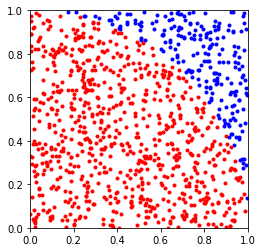

In [10]:
# area of circle with Monte Carlo
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import warnings

fig = plt.figure()
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.axes().set_aspect('equal')

counter_inside = 0
counter_total = 0

def animate(i):
    global counter_inside, counter_total
    counter_total += 1
    point = np.random.rand(2)
    
    if np.sqrt(point[0]**2+point[1]**2) < 1:
        plt.plot(point[0], point[1], 'r.')
        counter_inside += 1
    else:
        plt.plot(point[0], point[1], 'b.')


simulation = animation.FuncAnimation(fig, animate, frames = 1000, interval=10, repeat = False)

from IPython.display import HTML
HTML(simulation.to_jshtml())

In [11]:
print("ratio = ", counter_inside/counter_total)
print("true value (pi/4) = ", np.pi/4)

ratio =  0.779441117764471
true value (pi/4) =  0.7853981633974483
